<Functional name=vgg19, built=True>
J_content = tf.Tensor(7.056877, shape=(), dtype=float32)
'KerasTensor' object has no attribute 'get_shape'
GA = 
tf.Tensor(
[[ 63.188793  -26.721273   -7.7320204]
 [-26.721273   12.76758    -2.5158243]
 [ -7.7320204  -2.5158243  23.752384 ]], shape=(3, 3), dtype=float32)
J_style_layer = tf.Tensor(14.017806, shape=(), dtype=float32)
J_style_layer = tf.Tensor(14.017806, shape=(), dtype=float32)
input_layer_6
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


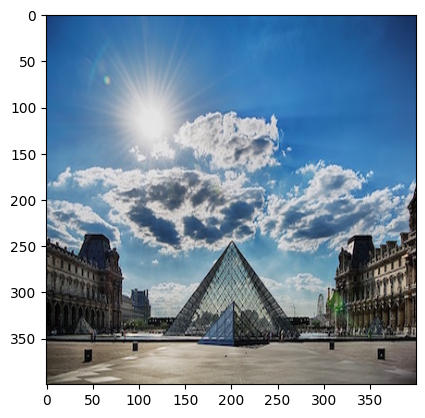

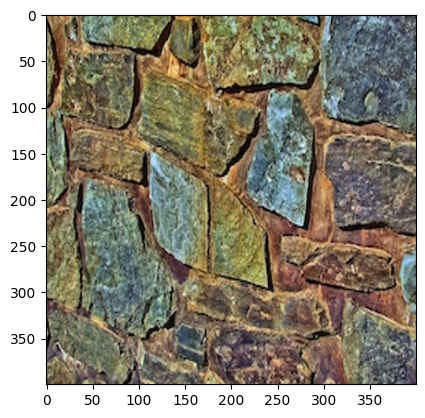

(1, 400, 400, 3)


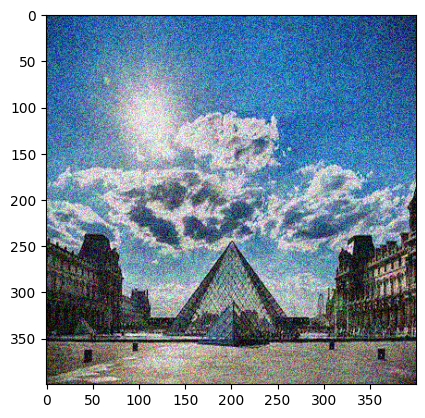

tf.Tensor(29883.762, shape=(), dtype=float32)
tf.Tensor(16520.629, shape=(), dtype=float32)
Epoch 0 


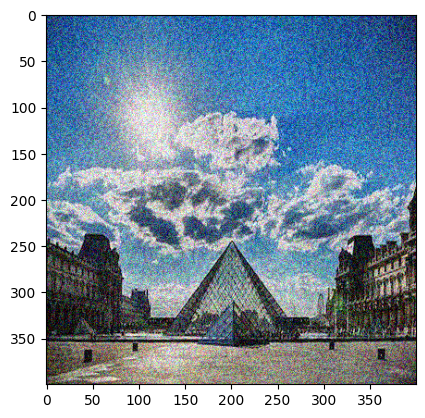

Epoch 50 


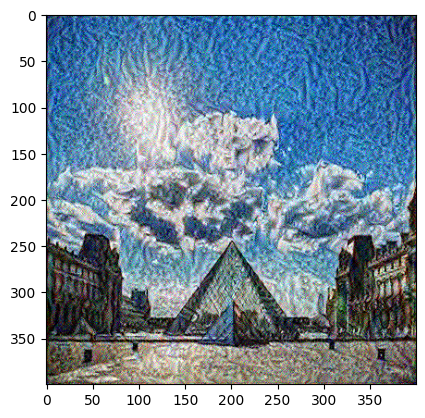

Epoch 100 


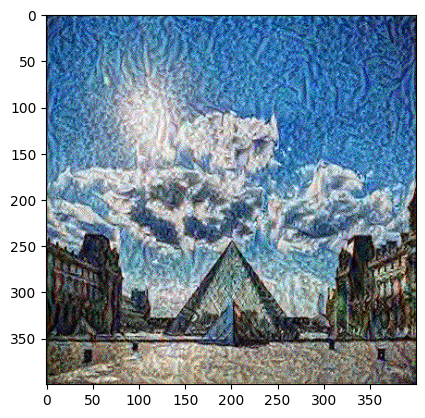

Epoch 150 


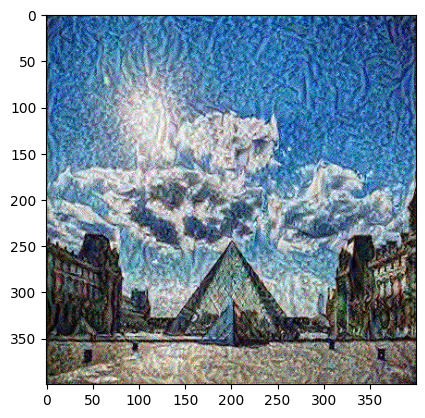

Epoch 200 


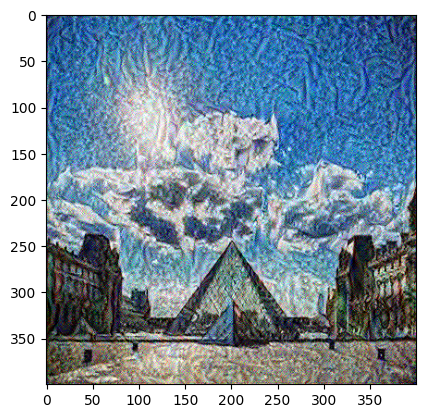

Epoch 250 


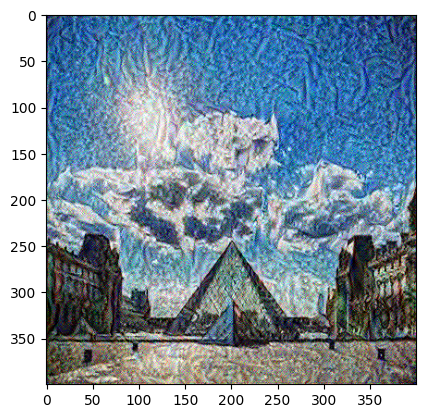

Epoch 300 


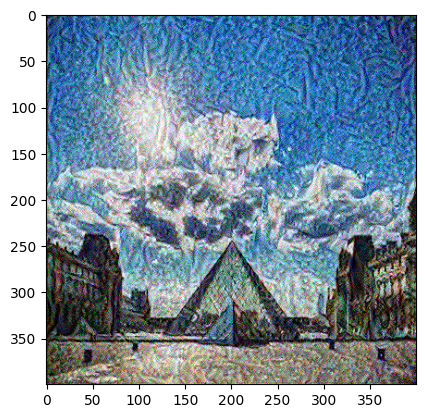

Epoch 350 


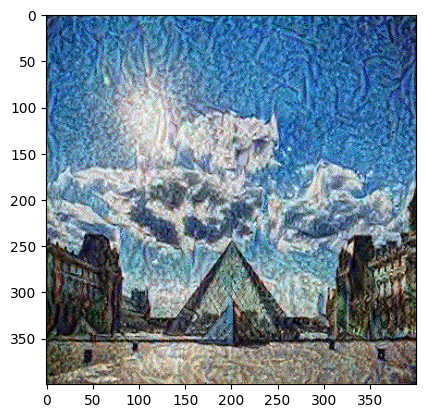

Epoch 400 


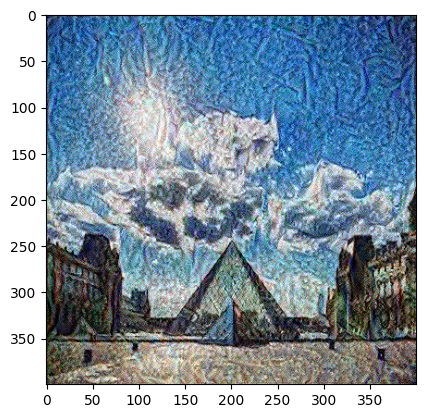

Epoch 450 


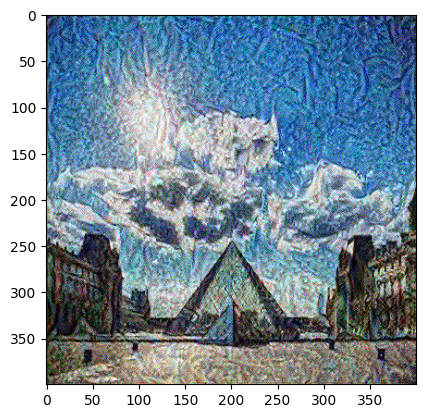

Epoch 500 


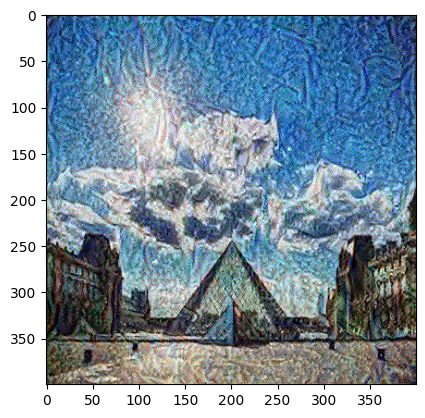

Epoch 550 


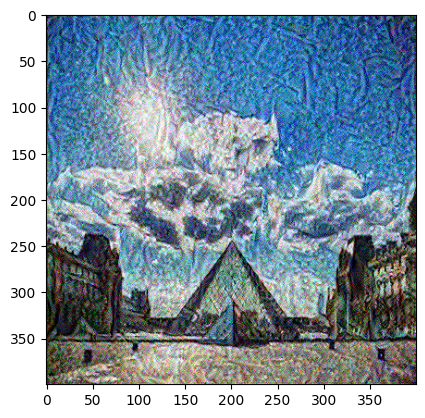

Epoch 600 


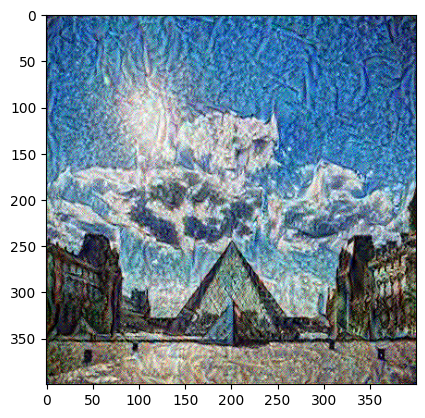

Epoch 650 


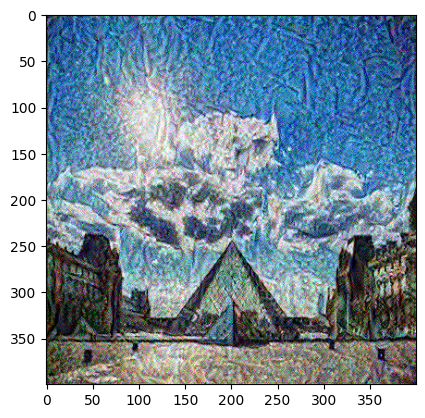

Epoch 700 


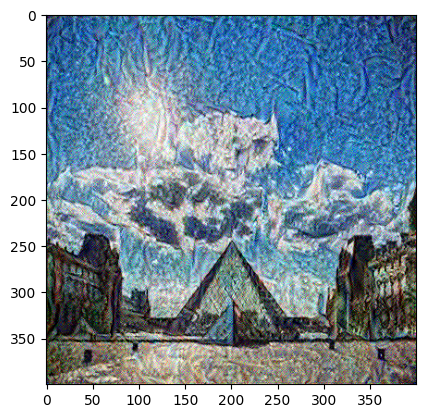

Epoch 750 


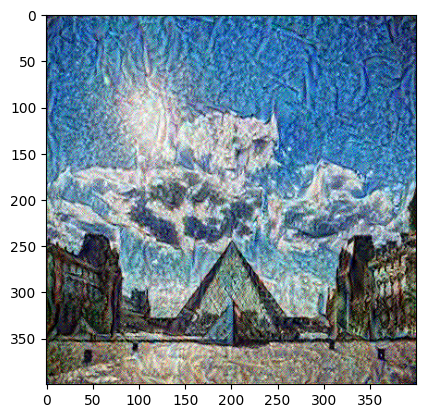

Epoch 800 


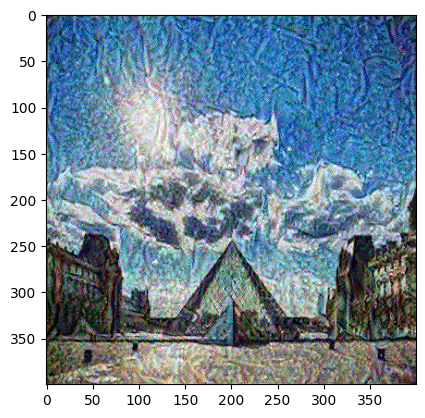

Epoch 850 


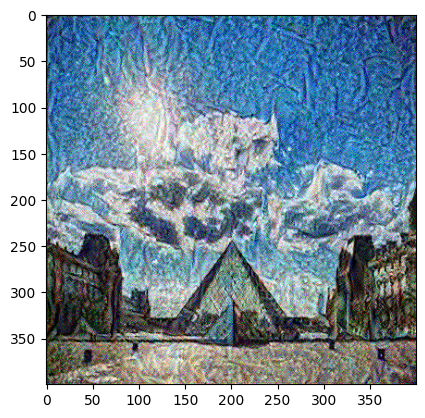

Epoch 900 


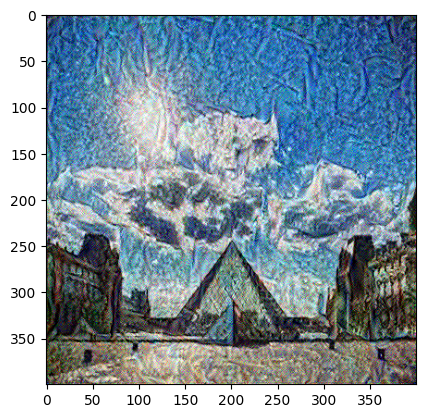

Epoch 950 


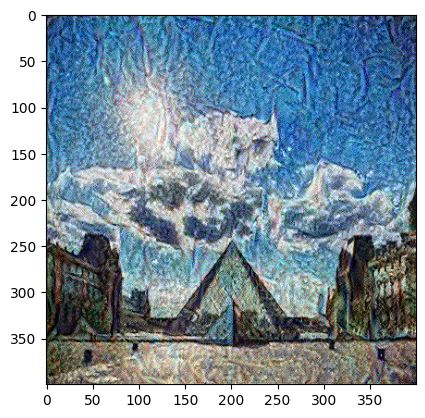

Epoch 1000 


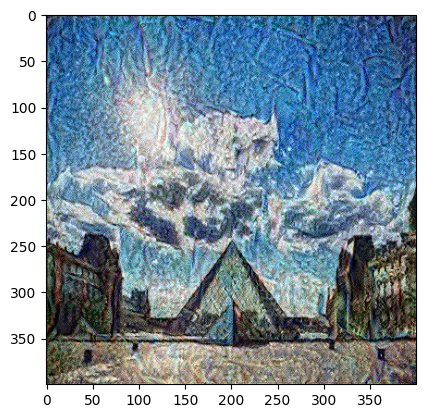

Epoch 1050 


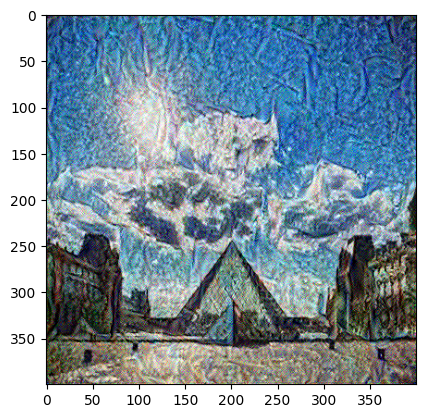

Epoch 1100 


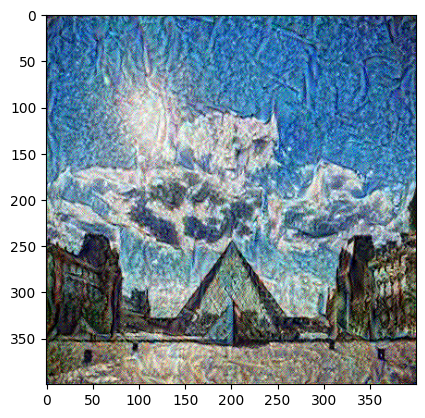

Epoch 1150 


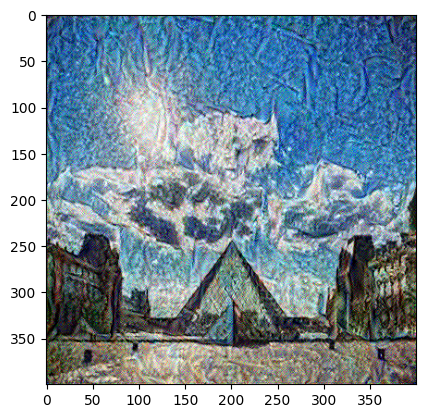

Epoch 1200 


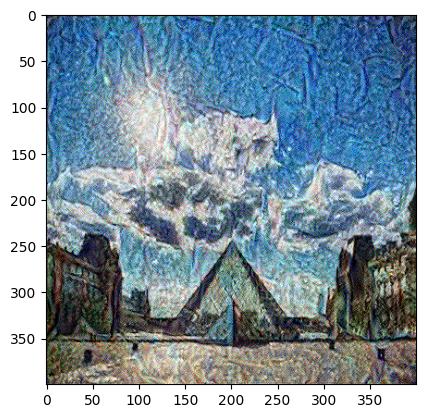

Epoch 1250 


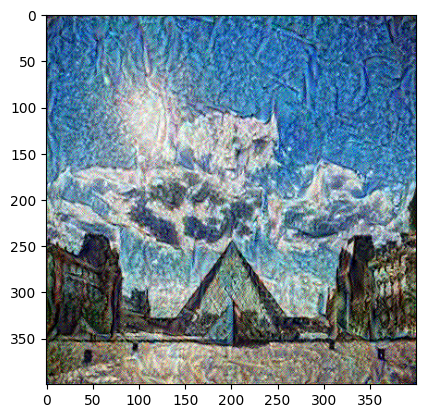

Epoch 1300 


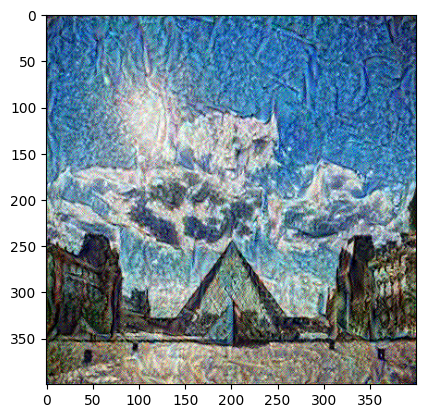

Epoch 1350 


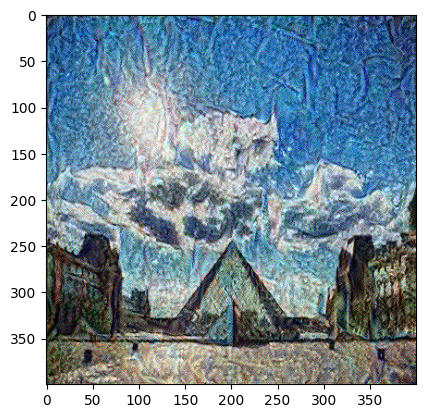

Epoch 1400 


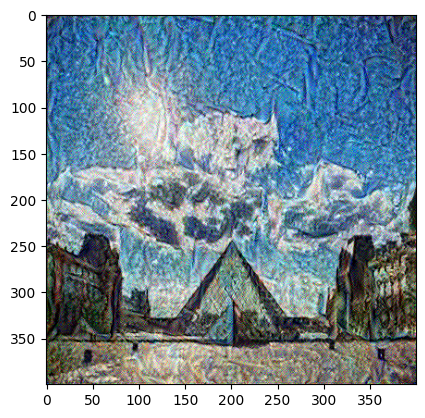

Epoch 1450 


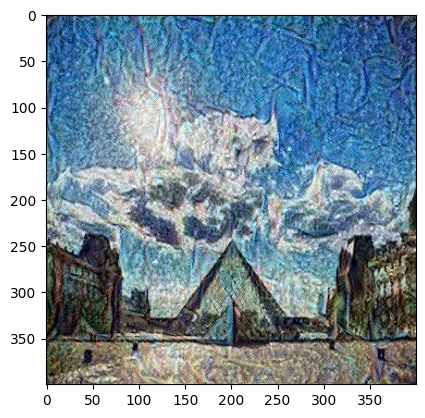

Epoch 1500 


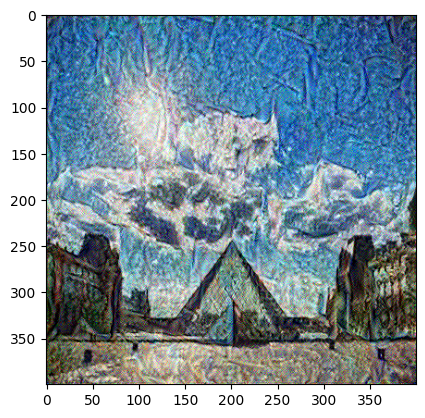

Epoch 1550 


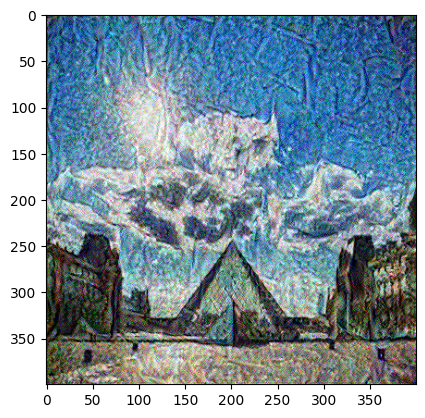

Epoch 1600 


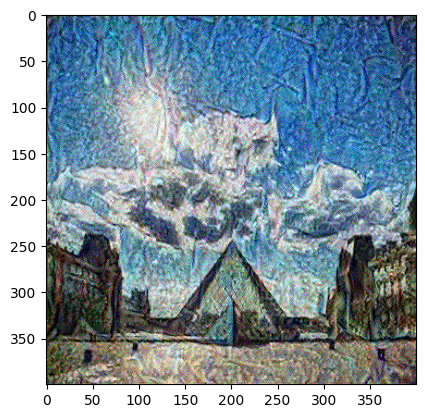

Epoch 1650 


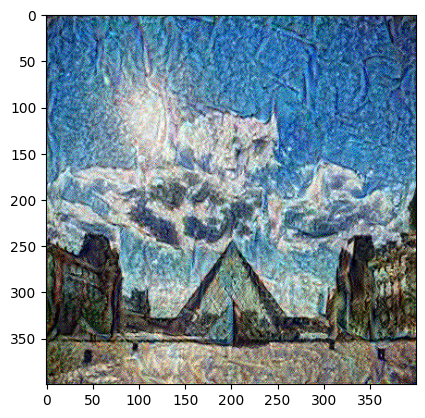

Epoch 1700 


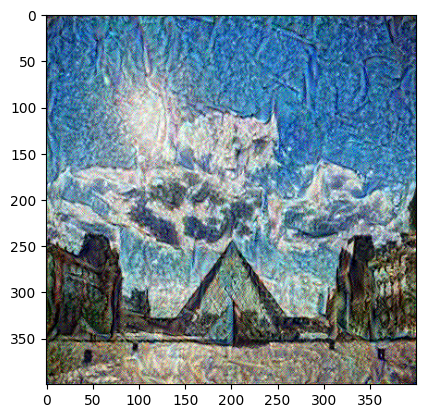

Epoch 1750 


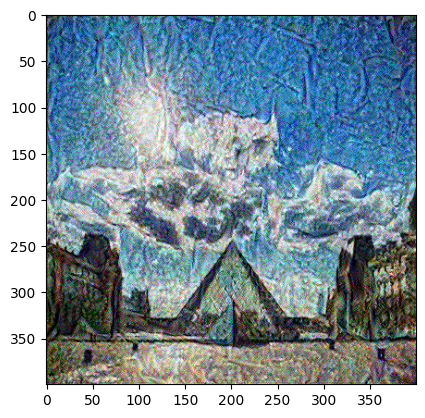

Epoch 1800 


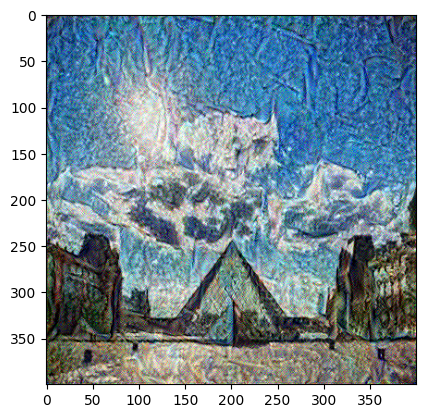

Epoch 1850 


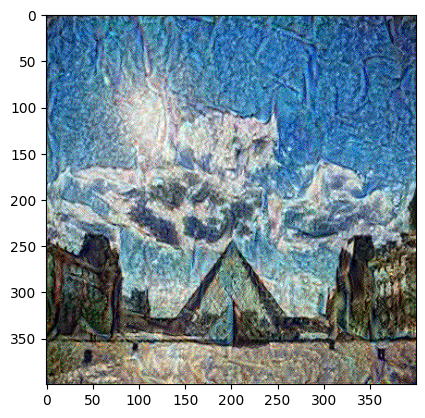

Epoch 1900 


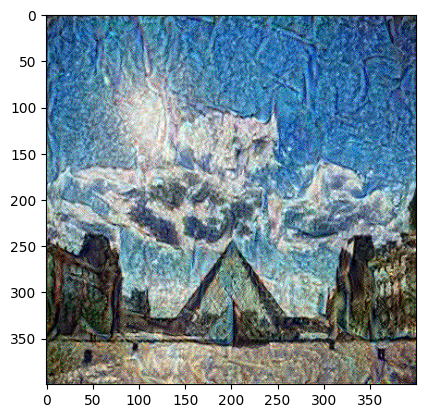

Epoch 1950 


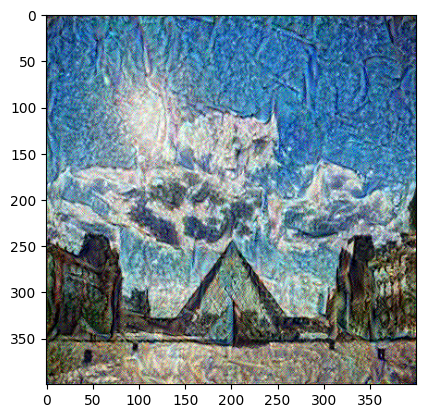

Epoch 2000 


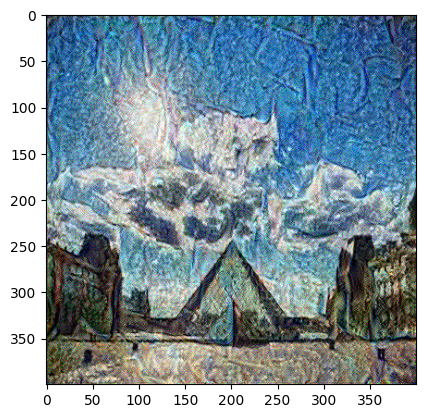

Epoch 2050 


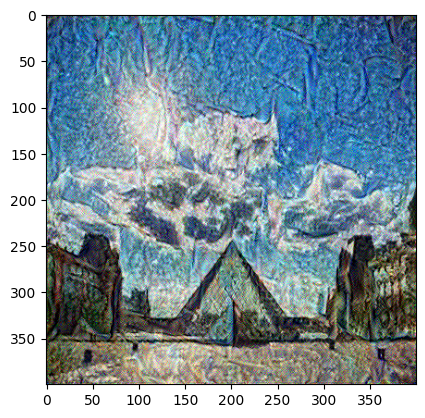

Epoch 2100 


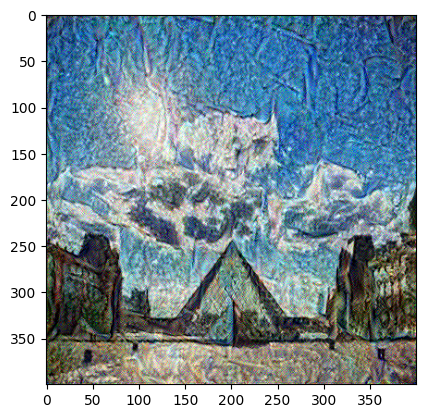

Epoch 2150 


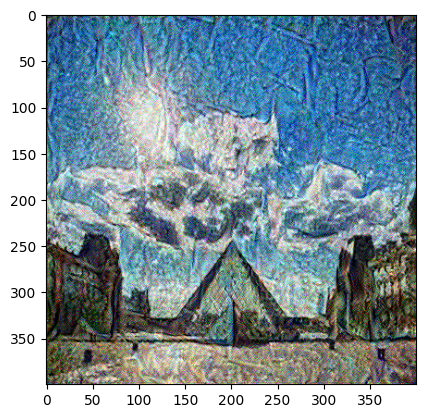

Epoch 2200 


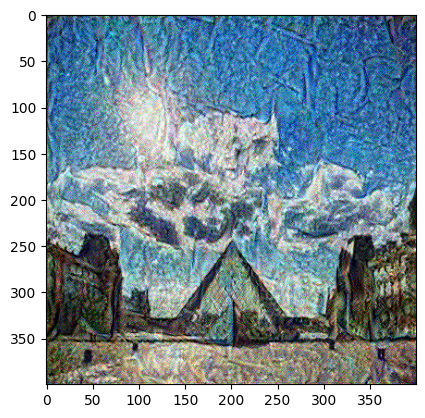

Epoch 2250 


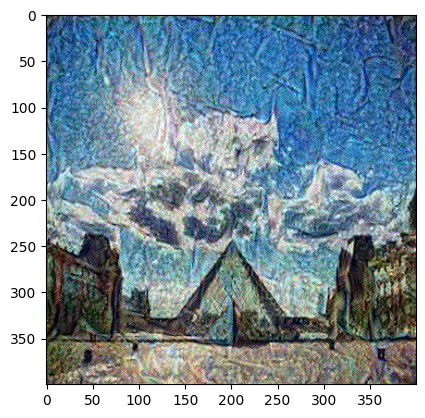

Epoch 2300 


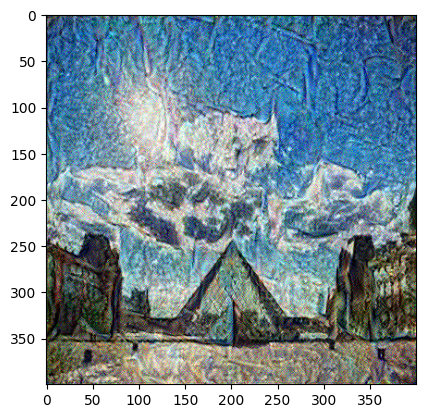

Epoch 2350 


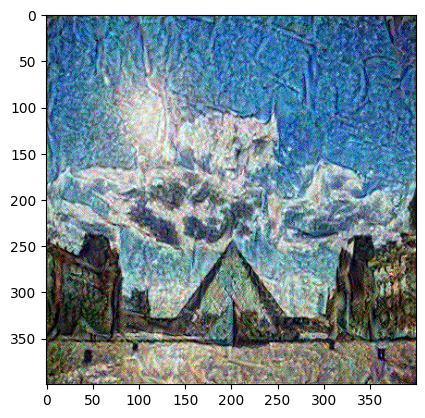

Epoch 2400 


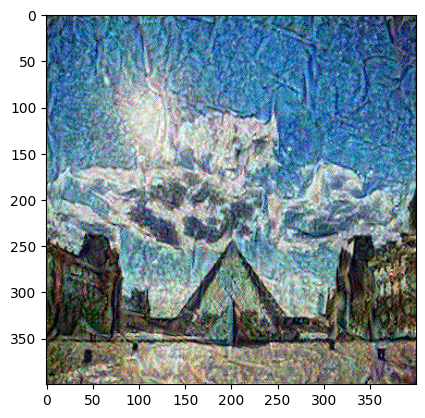

Epoch 2450 


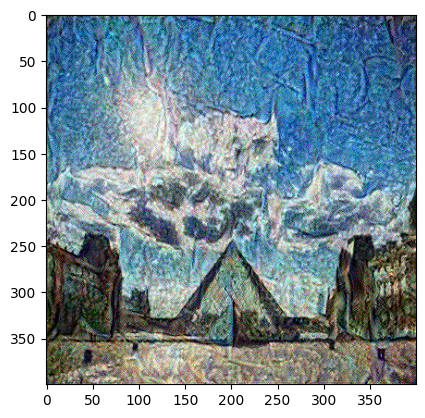

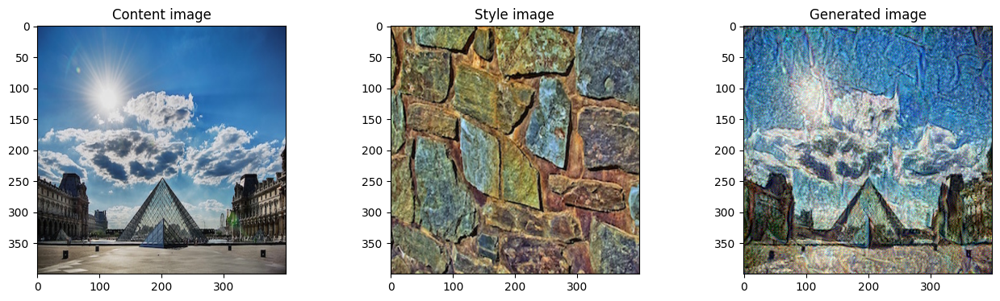

In [4]:
import os
import sys
import scipy.io
import scipy.misc
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
from PIL import Image
import numpy as np
import tensorflow as tf
import pprint
%matplotlib inline
from tensorflow.python.framework.ops import EagerTensor

class CONFIG:
    IMAGE_WIDTH = 400
    IMAGE_HEIGHT = 300
    COLOR_CHANNELS = 3
    NOISE_RATIO = 0.6
    MEANS = np.array([123.68, 116.779, 103.939]).reshape((1,1,1,3))
    VGG_MODEL = 'pretrained-model/imagenet-vgg-verydeep-19.mat' # Pick the VGG 19-layer model by from the paper "Very Deep Convolutional Networks for Large-Scale Image Recognition".
    STYLE_IMAGE = 'images/stone_style.jpg' # Style image to use.
    CONTENT_IMAGE = 'images/content300.jpg' # Content image to use.
    OUTPUT_DIR = 'output/'

def load_vgg_model(path):
    vgg = scipy.io.loadmat(path)
    vgg_layers = vgg['layers']

    def _weights(layer, expected_layer_name):

        wb = vgg_layers[0][layer][0][0][2]
        W = wb[0][0]
        b = wb[0][1]
        layer_name = vgg_layers[0][layer][0][0][0][0]
        assert layer_name == expected_layer_name
        return W, b

        return W, b

    def _relu(conv2d_layer):
        return tf.nn.relu(conv2d_layer)

    def _conv2d(prev_layer, layer, layer_name):

        W, b = _weights(layer, layer_name)
        W = tf.constant(W)
        b = tf.constant(np.reshape(b, (b.size)))
        return tf.nn.conv2d(prev_layer, filter=W, strides=[1, 1, 1, 1], padding='SAME') + b

    def _conv2d_relu(prev_layer, layer, layer_name):
        return _relu(_conv2d(prev_layer, layer, layer_name))

    def _avgpool(prev_layer):
        return tf.nn.avg_pool(prev_layer, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME')

    # Constructs the graph model.
    graph = {}
    graph['input']   = tf.Variable(np.zeros((1, CONFIG.IMAGE_HEIGHT, CONFIG.IMAGE_WIDTH, CONFIG.COLOR_CHANNELS)), dtype = 'float32')
    graph['conv1_1']  = _conv2d_relu(graph['input'], 0, 'conv1_1')
    graph['conv1_2']  = _conv2d_relu(graph['conv1_1'], 2, 'conv1_2')
    graph['avgpool1'] = _avgpool(graph['conv1_2'])
    graph['conv2_1']  = _conv2d_relu(graph['avgpool1'], 5, 'conv2_1')
    graph['conv2_2']  = _conv2d_relu(graph['conv2_1'], 7, 'conv2_2')
    graph['avgpool2'] = _avgpool(graph['conv2_2'])
    graph['conv3_1']  = _conv2d_relu(graph['avgpool2'], 10, 'conv3_1')
    graph['conv3_2']  = _conv2d_relu(graph['conv3_1'], 12, 'conv3_2')
    graph['conv3_3']  = _conv2d_relu(graph['conv3_2'], 14, 'conv3_3')
    graph['conv3_4']  = _conv2d_relu(graph['conv3_3'], 16, 'conv3_4')
    graph['avgpool3'] = _avgpool(graph['conv3_4'])
    graph['conv4_1']  = _conv2d_relu(graph['avgpool3'], 19, 'conv4_1')
    graph['conv4_2']  = _conv2d_relu(graph['conv4_1'], 21, 'conv4_2')
    graph['conv4_3']  = _conv2d_relu(graph['conv4_2'], 23, 'conv4_3')
    graph['conv4_4']  = _conv2d_relu(graph['conv4_3'], 25, 'conv4_4')
    graph['avgpool4'] = _avgpool(graph['conv4_4'])
    graph['conv5_1']  = _conv2d_relu(graph['avgpool4'], 28, 'conv5_1')
    graph['conv5_2']  = _conv2d_relu(graph['conv5_1'], 30, 'conv5_2')
    graph['conv5_3']  = _conv2d_relu(graph['conv5_2'], 32, 'conv5_3')
    graph['conv5_4']  = _conv2d_relu(graph['conv5_3'], 34, 'conv5_4')
    graph['avgpool5'] = _avgpool(graph['conv5_4'])

    return graph

def generate_noise_image(content_image, noise_ratio = CONFIG.NOISE_RATIO):


    # Generate a random noise_image
    noise_image = np.random.uniform(-20, 20, (1, CONFIG.IMAGE_HEIGHT, CONFIG.IMAGE_WIDTH, CONFIG.COLOR_CHANNELS)).astype('float32')

    # Set the input_image to be a weighted average of the content_image and a noise_image
    input_image = noise_image * noise_ratio + content_image * (1 - noise_ratio)

    return input_image


def reshape_and_normalize_image(image):


    # Reshape image to mach expected input of VGG16
    image = np.reshape(image, ((1,) + image.shape))

    # Substract the mean to match the expected input of VGG16
    image = image - CONFIG.MEANS

    return image


def save_image(path, image):

    # Un-normalize the image so that it looks good
    image = image + CONFIG.MEANS

    # Clip and Save the image
    image = np.clip(image[0], 0, 255).astype('uint8')
    scipy.misc.imsave(path, image)

def compute_content_cost_test(target):
    tf.random.set_seed(1)
    a_C = tf.random.normal([1, 1, 4, 4, 3], mean=1, stddev=4)
    a_G = tf.random.normal([1, 1, 4, 4, 3], mean=1, stddev=4)
    J_content = target(a_C, a_G)
    J_content_0 = target(a_C, a_C)

    print("J_content = " + str(J_content))
    ll = tf.keras.layers.Dense(8, activation='relu', input_shape=(1, 4, 4, 3))
    model_tmp = tf.keras.models.Sequential()
    model_tmp.add(ll)
    try:
        target(ll.output, ll.output)
    except Exception as inst:
        print(inst)



def gram_matrix_test(target):
    tf.random.set_seed(1)
    A = tf.random.normal([3, 2 * 1], mean=1, stddev=4)
    GA = target(A)

    print("GA = \n" + str(GA))




def compute_layer_style_cost_test(target):
    tf.random.set_seed(1)
    a_S = tf.random.normal([1, 4, 4, 3], mean=1, stddev=4)
    a_G = tf.random.normal([1, 4, 4, 3], mean=1, stddev=4)
    J_style_layer_GG = target(a_G, a_G)
    J_style_layer_SG = target(a_S, a_G)

    print("J_style_layer = " + str(J_style_layer_SG))






def total_cost_test(target):
    J_content = 0.2
    J_style = 0.8
    J = target(J_content, J_style)

    np.random.seed(1)
    print("J = " + str(target(np.random.uniform(0, 1), np.random.uniform(0, 1))))




def train_step_test(target, generated_image):
    generated_image = tf.Variable(generated_image)
    J1 = target(generated_image)
    print(J1)
    J2 = target(generated_image)
    print(J2)

tf.random.set_seed(272)
pp = pprint.PrettyPrinter(indent=4)
img_size = 400
vgg = tf.keras.applications.VGG19(include_top=False,
                                  input_shape=(img_size, img_size, 3),
                                  weights='imagenet')

vgg.trainable = False
pp.pprint(vgg)

content_image = Image.open("images/louvre.jpg")
content_image


def compute_content_cost(content_output, generated_output):

    a_C = content_output[-1]
    a_G = generated_output[-1]


    # Retrieve dimensions from a_G (≈1 line)
    m, n_H, n_W, n_C = a_G.get_shape().as_list()

    # Reshape a_C and a_G (≈2 lines)
    a_C_unrolled = tf.reshape(a_C, shape=[m, n_H * n_W, n_C]) # Or tf.reshape(a_C, shape=[m, -1 , n_C])
    a_G_unrolled = tf.reshape(a_G, shape=[m, n_H * n_W, n_C]) # Or tf.reshape(a_G, shape=[m, -1 , n_C])

    # compute the cost with tensorflow (≈1 line)
    J_content = tf.reduce_sum(tf.square(a_C_unrolled - a_G_unrolled))/(4.0 * n_H * n_W * n_C)


    return J_content

compute_content_cost_test(compute_content_cost)

example = Image.open("images/stone_style.jpg")
example

def gram_matrix(A):
  GA = tf.matmul(A, tf.transpose(A))
  return GA

tf.random.set_seed(1)
A = tf.random.normal([3, 2 * 1], mean=1, stddev=4)
GA = gram_matrix(A)

print("GA = \n" + str(GA))

def compute_layer_style_cost(a_S, a_G):
      # Retrieve dimensions from a_G (≈1 line)
      m, n_H, n_W, n_C = a_G.get_shape().as_list()
      # Reshape the tensors from (1, n_H, n_W, n_C) to (n_C, n_H * n_W) (≈2 lines)
      a_S = tf.transpose(tf.reshape(a_S, shape=[-1, n_C]))
      a_G = tf.transpose(tf.reshape(a_G, shape=[-1, n_C]))
      # Computing gram_matrices for both images S and G (≈2 lines)
      GS = gram_matrix(a_S)
      GG = gram_matrix(a_G)
      # Computing the loss (≈1 line)
      J_style_layer = tf.reduce_sum(tf.square(GS - GG))/(4.0 *(( n_H * n_W * n_C)**2))

      return J_style_layer

tf.random.set_seed(1)
a_S = tf.random.normal([1, 4, 4, 3], mean=1, stddev=4)
a_G = tf.random.normal([1, 4, 4, 3], mean=1, stddev=4)
J_style_layer_GG = compute_layer_style_cost(a_G, a_G)
J_style_layer_SG = compute_layer_style_cost(a_S, a_G)

print("J_style_layer = " + str(J_style_layer_SG))
compute_layer_style_cost_test(compute_layer_style_cost)

for layer in vgg.layers:
    print(layer.name)

vgg.get_layer('block5_conv4').output

STYLE_LAYERS = [
  ('block1_conv1', 0.2),
  ('block2_conv1', 0.2),
  ('block3_conv1', 0.2),
  ('block4_conv1', 0.2),
  ('block5_conv1', 0.2)]



def compute_style_cost(style_image_output, generated_image_output, STYLE_LAYERS=STYLE_LAYERS):
    # initialize the overall style cost
    J_style = 0
    # Set a_S to be the hidden layer activation from the layer we have selected.
    # The last element of the array contains the content layer image, which must not be used.
    a_S = style_image_output[:-1]
    # Set a_G to be the output of the choosen hidden layers.
    # The last element of the list contains the content layer image which must not be used.
    a_G = generated_image_output[:-1]
    for i, weight in zip(range(len(a_S)), STYLE_LAYERS):
        # Compute style_cost for the current layer
        J_style_layer = compute_layer_style_cost(a_S[i], a_G[i])
        # Add weight * J_style_layer of this layer to overall style cost
        J_style += weight[1] * J_style_layer

    return J_style

@tf.function()
def total_cost(J_content, J_style, alpha = 10, beta = 40):
    J = alpha * J_content + beta * J_style
    return J

content_image = np.array(Image.open("images/louvre_small.jpg").resize((img_size, img_size)))
content_image = tf.constant(np.reshape(content_image, ((1,) + content_image.shape)))

# print(content_image.shape)
imshow(content_image[0])
plt.show()

style_image =  np.array(Image.open("images/stone_style.jpg").resize((img_size, img_size)))
style_image = tf.constant(np.reshape(style_image, ((1,) + style_image.shape)))

# print(style_image.shape)
imshow(style_image[0])
plt.show()


generated_image = tf.Variable(tf.image.convert_image_dtype(content_image, tf.float32))
noise = tf.random.uniform(tf.shape(generated_image), -0.25, 0.25)
generated_image = tf.add(generated_image, noise)
generated_image = tf.clip_by_value(generated_image, clip_value_min=0.0, clip_value_max=1.0)

print(generated_image.shape)
imshow(generated_image.numpy()[0])
plt.show()

def get_layer_outputs(vgg, layer_names):
    outputs = [vgg.get_layer(layer[0]).output for layer in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

content_layer = [('block5_conv4', 1)]

vgg_model_outputs = get_layer_outputs(vgg, STYLE_LAYERS + content_layer)

content_target = vgg_model_outputs(content_image)  # Content encoder
style_targets = vgg_model_outputs(style_image)     # Style encoder

# Assign the content image to be the input of the VGG model.
# Set a_C to be the hidden layer activation from the layer we have selected
preprocessed_content =  tf.Variable(tf.image.convert_image_dtype(content_image, tf.float32))
a_C = vgg_model_outputs(preprocessed_content)
# Assign the input of the model to be the "style" image
preprocessed_style =  tf.Variable(tf.image.convert_image_dtype(style_image, tf.float32))
a_S = vgg_model_outputs(preprocessed_style)

def clip_0_1(image):

    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

def tensor_to_image(tensor):

    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return Image.fromarray(tensor)

optimizer = tf.keras.optimizers.Adam(learning_rate=0.01)

@tf.function()
def train_step(generated_image):
    with tf.GradientTape() as tape:
        #use the precomputed encoded images a_S and a_C
        # Compute a_G as the vgg_model_outputs for the current generated image
        a_G = vgg_model_outputs(generated_image)
        # Compute the style cost
        J_style = compute_style_cost(a_S, a_G)
        # Compute the content cost
        J_content = compute_content_cost(a_C, a_G)
        # Compute the total cost
        J = total_cost(J_content, J_style,alpha = 10, beta = 40)
    grad = tape.gradient(J, generated_image)
    optimizer.apply_gradients([(grad, generated_image)])
    generated_image.assign(clip_0_1(generated_image))
    return J

generated_image = tf.Variable(generated_image)
train_step_test(train_step, generated_image)
# Show the generated image at some epochs
# Uncomment to reset the style transfer process. You will need to compile the train_step function again
epochs = 2500
for i in range(epochs):
    train_step(generated_image)
    if i % 50 == 0:
        print(f"Epoch {i} ")
    if i % 50 == 0:
        image = tensor_to_image(generated_image)
        imshow(image)
        image.save(f"output/image_{i}.jpg")
        plt.show()

# Show the 3 images in a row
fig = plt.figure(figsize=(16, 4))
ax = fig.add_subplot(1, 3, 1)
imshow(content_image[0])
ax.title.set_text('Content image')
ax = fig.add_subplot(1, 3, 2)
imshow(style_image[0])
ax.title.set_text('Style image')
ax = fig.add_subplot(1, 3, 3)
imshow(generated_image[0])
ax.title.set_text('Generated image')
plt.show()